In [1]:
!nvidia-smi

Thu Apr 10 03:59:04 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 565.57.01              Driver Version: 565.57.01      CUDA Version: 12.7     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA RTX 6000 Ada Gene...    On  |   00000000:91:00.0 Off |                  Off |
| 30%   28C    P8             21W /  300W |       2MiB /  49140MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [2]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="G4E2s4zPdEcH3fidyijT")
project = rf.workspace("works-ly0n7").project("surgical-segmentation-yh9n7")
version = project.version(3)
dataset = version.download("yolov11")

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 84.5/84.5 KB 973.6 kB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 23.3 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 KB 47.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 KB 19.0 MB/s eta 0:00:00
  Using cached filetype-1.2.0-py2.py3-none-any.whl (19 kB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 30.2 MB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.6/8.6 MB 30.6 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 24.0 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 325.0/325.0 KB 35.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 111.1/111.1 KB 52.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.6/4.6 MB 32.0 MB/s eta 0:00:0000:0100:01
  Attempting uninstall: idna
    Found existing installation: idna 3.10
    Unins


Extracting Dataset Version Zip to surgical-segmentation-3 in yolov11:: 100%|██████████| 2321/2321 [00:00<00:00, 9386.30it/s]


In [6]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 994.0/994.0 KB 4.1 MB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.0/63.0 MB 20.1 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.3/16.3 MB 27.9 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 294.9/294.9 KB 38.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 37.6/37.6 MB 25.0 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.1/13.1 MB 30.1 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 347.8/347.8 KB 34.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 509.2/509.2 KB 34.2 MB/s eta 0:00:00
  Attempting uninstall: numpy
    Found existing installation: numpy 2.1.2
    Uninstalling numpy-2.1.2:
      Successfully uninstalled numpy-2.1.2


In [3]:
classs = ['image', 'person', 'surgical-area', 'surgical-tool', 'text']
with open('classes.txt', 'w') as f:
  for c in classs:
    f.write(c + '\n')

In [4]:
# Python function to automatically create data.yaml config file
# 1. Reads "classes.txt" file to get list of class names
# 2. Creates data dictionary with correct paths to folders, number of classes, and names of classes
# 3. Writes data in YAML format to data.yaml

import yaml
import os

def create_data_yaml(path_to_classes_txt, path_to_data_yaml):

  # Read class.txt to get class names
  if not os.path.exists(path_to_classes_txt):
    print(f'classes.txt file not found! Please create a classes.txt labelmap and move it to {path_to_classes_txt}')
    return
  with open(path_to_classes_txt, 'r') as f:
    classes = []
    for line in f.readlines():
      if len(line.strip()) == 0: continue
      classes.append(line.strip())
  number_of_classes = len(classes)

  # Create data dictionary
  data = {
      'path': 'surgical-segmentation-3',
      'train': 'train/images',
      'val': 'validation/images',
      'nc': number_of_classes,
      'names': classes
  }

  # Write data to YAML file
  with open(path_to_data_yaml, 'w') as f:
    yaml.dump(data, f, sort_keys=False)
  print(f'Created config file at {path_to_data_yaml}')

  return

# Define path to classes.txt and run function
path_to_classes_txt = 'classes.txt'
path_to_data_yaml = 'data.yaml'

create_data_yaml(path_to_classes_txt, path_to_data_yaml)

print('\nFile contents:\n')
!cat data.yaml

Created config file at data.yaml

File contents:

path: surgical-segmentation-3
train: train/images
val: validation/images
nc: 5
names:
- image
- person
- surgical-area
- surgical-tool
- text


In [11]:
!yolo segment train data=data.yaml model=yolo11m-seg.pt epochs=300 imgsz=640 patience=30

Ultralytics 8.3.105 🚀 Python-3.10.12 torch-2.6.0+cu124 CUDA:0 (NVIDIA RTX 6000 Ada Generation, 48536MiB)
engine/trainer: task=segment, mode=train, model=yolo11m-seg.pt, data=data.yaml, epochs=300, time=None, patience=30, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, 

In [8]:
!cat '/root/.config/Ultralytics/settings.json'

{
  "settings_version": "0.0.6",
  "datasets_dir": "/home/datasets",
  "weights_dir": "weights",
  "runs_dir": "runs",
  "uuid": "af86e989f891cbd0cd78de981596cc553f47f4a708b5ec210405ae2024cb9aec",
  "sync": true,
  "api_key": "",
  "openai_api_key": "",
  "clearml": true,
  "comet": true,
  "dvc": true,
  "hub": true,
  "mlflow": true,
  "neptune": true,
  "raytune": true,
  "tensorboard": true,
  "wandb": false,
  "vscode_msg": true
}

In [16]:
!yolo segment predict model=runs/segment/train2/weights/best.pt source=datasets/surgical-segmentation-3/validation/images/ save=True

Ultralytics 8.3.105 🚀 Python-3.10.12 torch-2.6.0+cu124 CUDA:0 (NVIDIA RTX 6000 Ada Generation, 48536MiB)
YOLO11m-seg summary (fused): 138 layers, 22,339,167 parameters, 0 gradients, 123.0 GFLOPs

image 1/218 /home/datasets/surgical-segmentation-3/validation/images/1035612_28_jpg.rf.df8ae7d934bad40a6362de832eb23526.jpg: 640x640 3 surgical-areas, 1 surgical-tool, 5.7ms
image 2/218 /home/datasets/surgical-segmentation-3/validation/images/1035612_31_jpg.rf.62c2cce69bbc4e2bf084393892d7b855.jpg: 640x640 1 surgical-area, 1 surgical-tool, 6.1ms
image 3/218 /home/datasets/surgical-segmentation-3/validation/images/1035612_33_jpg.rf.759e89bc5767fba184cbb0e23de4d1f1.jpg: 640x640 1 surgical-area, 1 surgical-tool, 5.2ms
image 4/218 /home/datasets/surgical-segmentation-3/validation/images/1035612_34_jpg.rf.a2fdef8f32e7a0999fa3418a3e6baaa4.jpg: 640x640 1 surgical-area, 1 surgical-tool, 5.1ms
image 5/218 /home/datasets/surgical-segmentation-3/validation/images/1035612_35_jpg.rf.945c46844ca627c0b6162d62

In [17]:
!pwd

/home


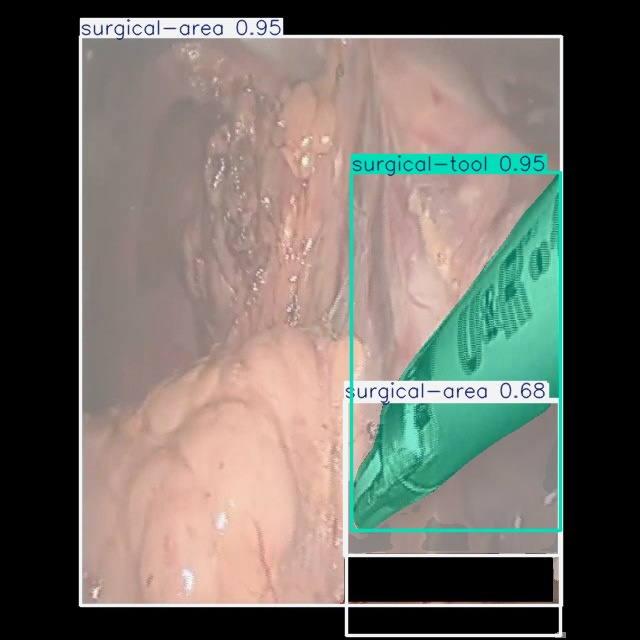

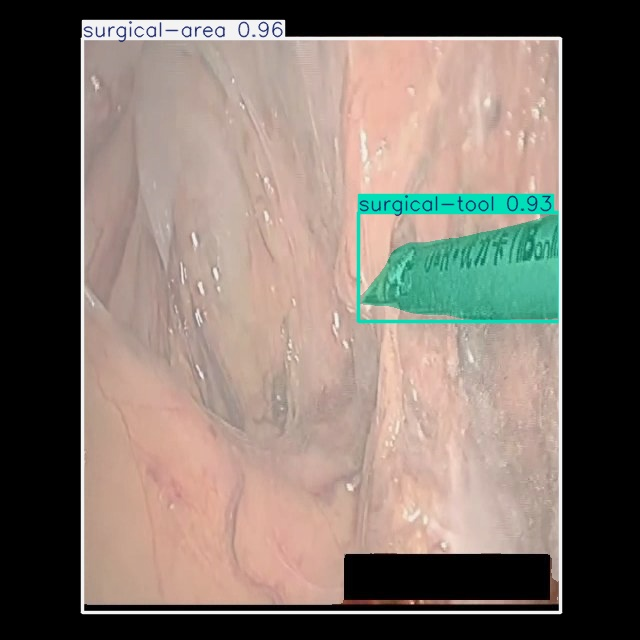

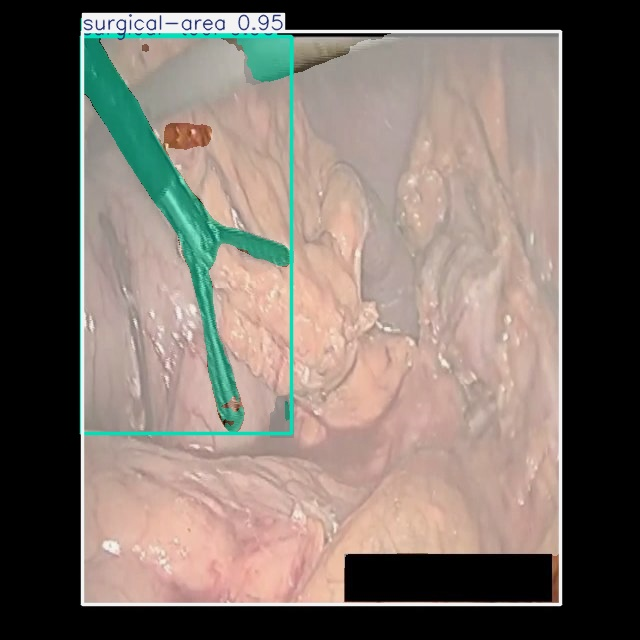

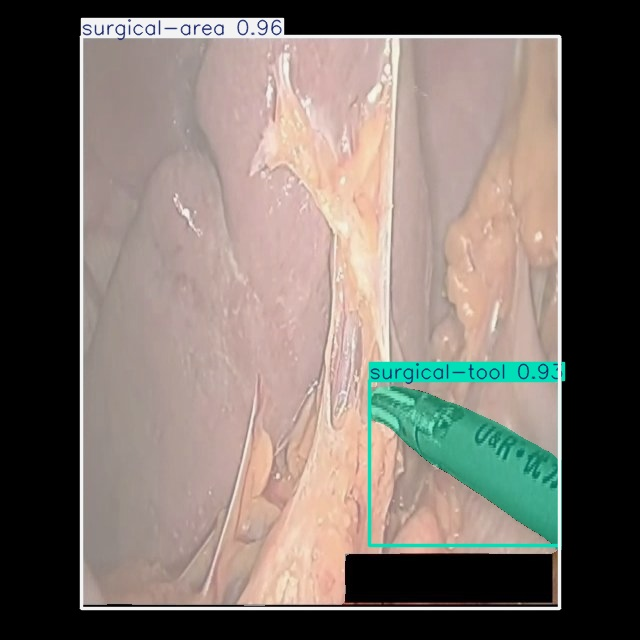

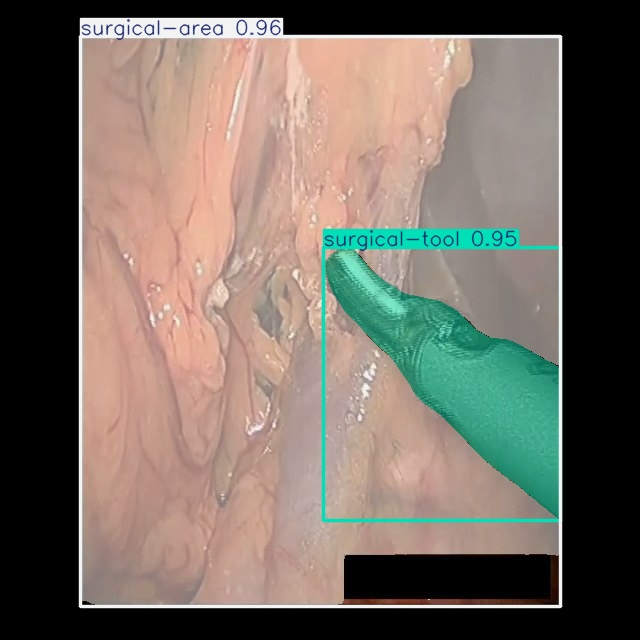

...

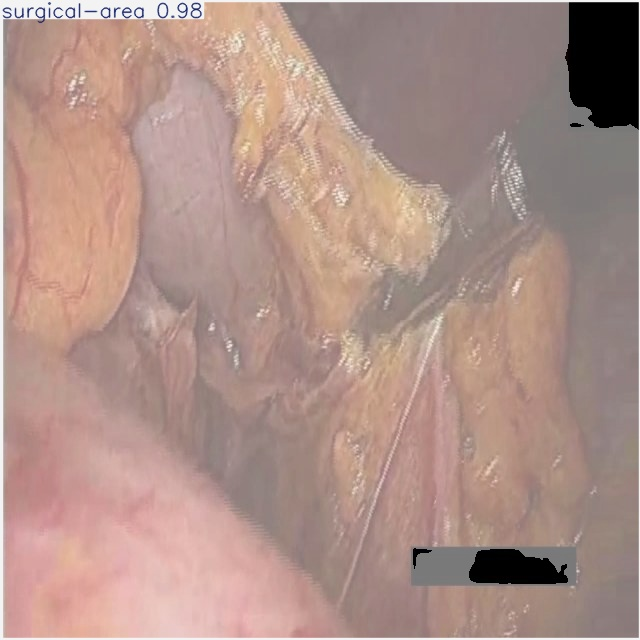

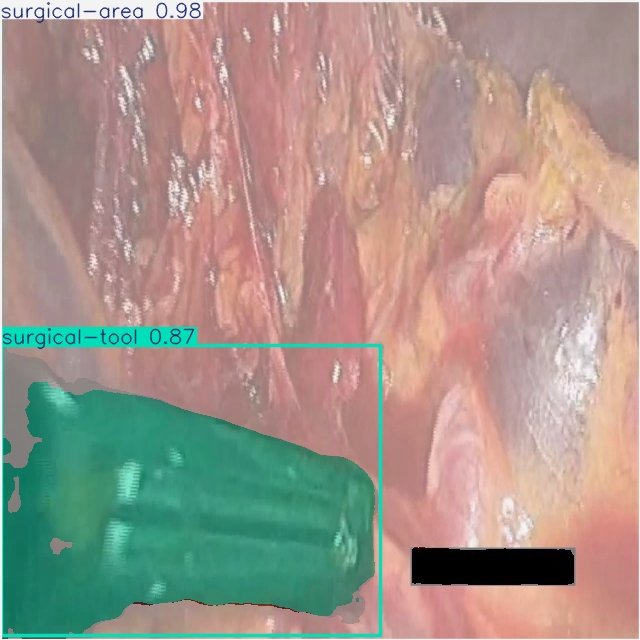

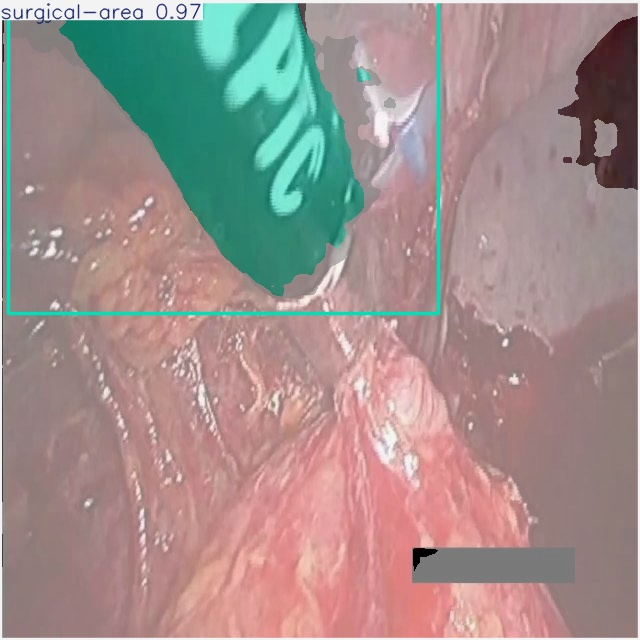

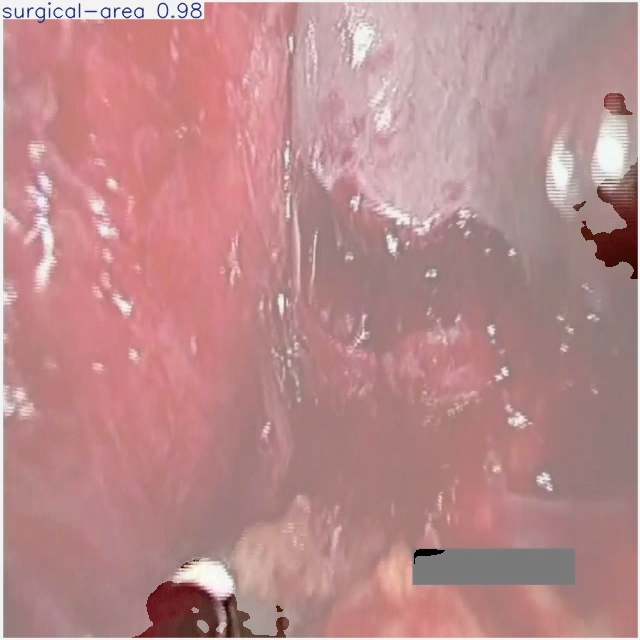

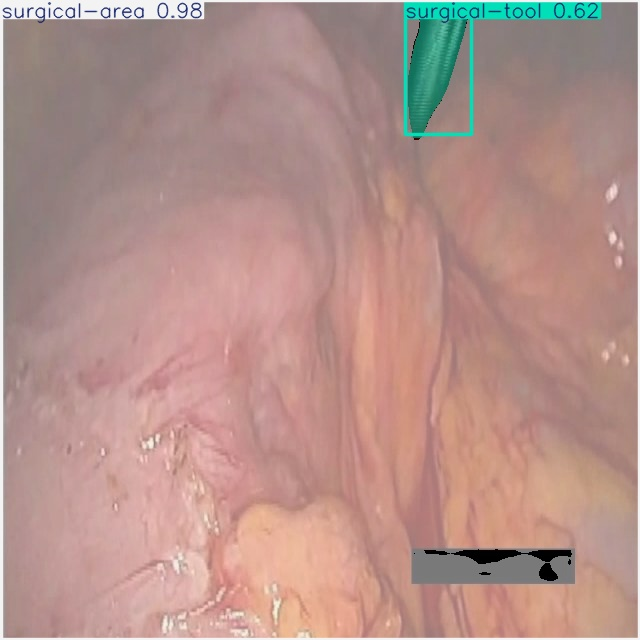

In [22]:
import glob
from IPython.display import Image, display
for image_path in glob.glob(f'runs/segment/predict/*.jpg')[:218]:
  display(Image(filename=image_path, height=400))
  print('\n')


In [17]:
!ls home/datasets/datasets/surgical-segmentation-3/validation/images

ls: cannot access 'home/datasets/datasets/surgical-segmentation-3/validation/images': No such file or directory


In [ ]:
import zipfile
import os

def zip_folder(folder_path, zip_output_path):
    """
    Zips the contents of a folder (including subfolders and files).
    
    Args:
        folder_path (str): Path to the folder you want to zip.
        zip_output_path (str): Full path to the output zip file.
    """
    with zipfile.ZipFile(zip_output_path, 'w', zipfile.ZIP_DEFLATED) as zipf:
        for root, dirs, files in os.walk(folder_path):
            for file in files:
                full_path = os.path.join(root, file)
                # Get the relative path to maintain the folder structure
                relative_path = os.path.relpath(full_path, start=folder_path)
                zipf.write(full_path, relative_path)

    print(f"✅ Folder '{folder_path}' zipped to '{zip_output_path}'")

# Example usage:
folder_to_zip = '/home'        # Replace with your folder
output_zip = 'my_archive.zip' # Replace with desired output zip path
zip_folder(folder_to_zip, output_zip)


In [9]:
!mkdir datasets

In [10]:
!mv surgical-segmentation-3 datasets